In [7]:
from ucimlrepo import fetch_ucirepo

import numpy as np
import pandas as pd
import matplotlib
from matplotlib import pyplot as plt
%matplotlib inline     
## use `%matplotlib notebook` for interactive figures
# plt.style.use('ggplot')
import sklearn

from tigramite import data_processing as pp
from tigramite.toymodels import structural_causal_processes as toys

from tigramite import plotting as tp
from tigramite.pcmci import PCMCI

from tigramite.independence_tests.parcorr import ParCorr

In [3]:
# fetch dataset 
appliances_energy_prediction = fetch_ucirepo(id=374) 
  
# data (as pandas dataframes) 
X = appliances_energy_prediction.data.features 
y = appliances_energy_prediction.data.targets 

In [4]:
X

,date,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,...,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
0,2016-01-1117:00:00,30,19.890000,47.596667,19.200000,44.790000,19.790000,44.730000,19.000000,45.566667,...,17.033333,45.5300,6.60,733.5,92.000000,7.000000,63.000000,5.3,13.275433,13.275433
1,2016-01-1117:10:00,30,19.890000,46.693333,19.200000,44.722500,19.790000,44.790000,19.000000,45.992500,...,17.066667,45.5600,6.48,733.6,92.000000,6.666667,59.166667,5.2,18.606195,18.606195
2,2016-01-1117:20:00,30,19.890000,46.300000,19.200000,44.626667,19.790000,44.933333,18.926667,45.890000,...,17.000000,45.5000,6.37,733.7,92.000000,6.333333,55.333333,5.1,28.642668,28.642668
3,2016-01-1117:30:00,40,19.890000,46.066667,19.200000,44.590000,19.790000,45.000000,18.890000,45.723333,...,17.000000,45.4000,6.25,733.8,92.000000,6.000000,51.500000,5.0,45.410390,45.410390
4,2016-01-1117:40:00,40,19.890000,46.333333,19.200000,44.530000,19.790000,45.000000,18.890000,45.530000,...,17.000000,45.4000,6.13,733.9,92.000000,5.666667,47.666667,4.9,10.084097,10.084097
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19730,2016-05-2717:20:00,0,25.566667,46.560000,25.890000,42.025714,27.200000,41.163333,24.700000,45.590000,...,23.200000,46.7900,22.70,755.2,55.666667,3.333333,23.666667,13.3,43.096812,43.096812
19731,2016-05-2717:30:00,0,25.500000,46.500000,25.754000,42.080000,27.133333,41.223333,24.700000,45.590000,...,23.200000,46.7900,22.60,755.2,56.000000,3.500000,24.500000,13.3,49.282940,49.282940
19732,2016-05-2717:40:00,10,25.500000,46.596667,25.628571,42.768571,27.050000,41.690000,24.700000,45.730000,...,23.200000,46.7900,22.50,755.2,56.333333,3.666667,25.333333,13.3,29.199117,29.199117
19733,2016-05-2717:50:00,10,25.500000,46.990000,25.414000,43.036000,26.890000,41.290000,24.700000,45.790000,...,23.200000,46.8175,22.30,755.2,56.666667,3.833333,26.166667,13.2,6.322784,6.322784


In [5]:
y

,Appliances
0,60
1,60
2,50
3,50
4,60
...,...
19730,100
19731,90
19732,270
19733,420


In [9]:
df_full = pd.concat([X, y], axis=1)

In [10]:
df_full.head(1)

,date,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,...,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2,Appliances
0,2016-01-1117:00:00,30,19.89,47.596667,19.2,44.79,19.79,44.73,19.0,45.566667,...,45.53,6.6,733.5,92.0,7.0,63.0,5.3,13.275433,13.275433,60


In [32]:
selected_vars = [1, 2, 3, 4, -1]
start_time = 0
end_time = 1000

In [55]:
df_filtered = df_full.iloc[start_time:end_time, 1:]

In [56]:
df_full_pp = pp.DataFrame(df_filtered.values, 
                         datatime = {0:np.arange(len(df_filtered))}, 
                         var_names=df_filtered.columns)

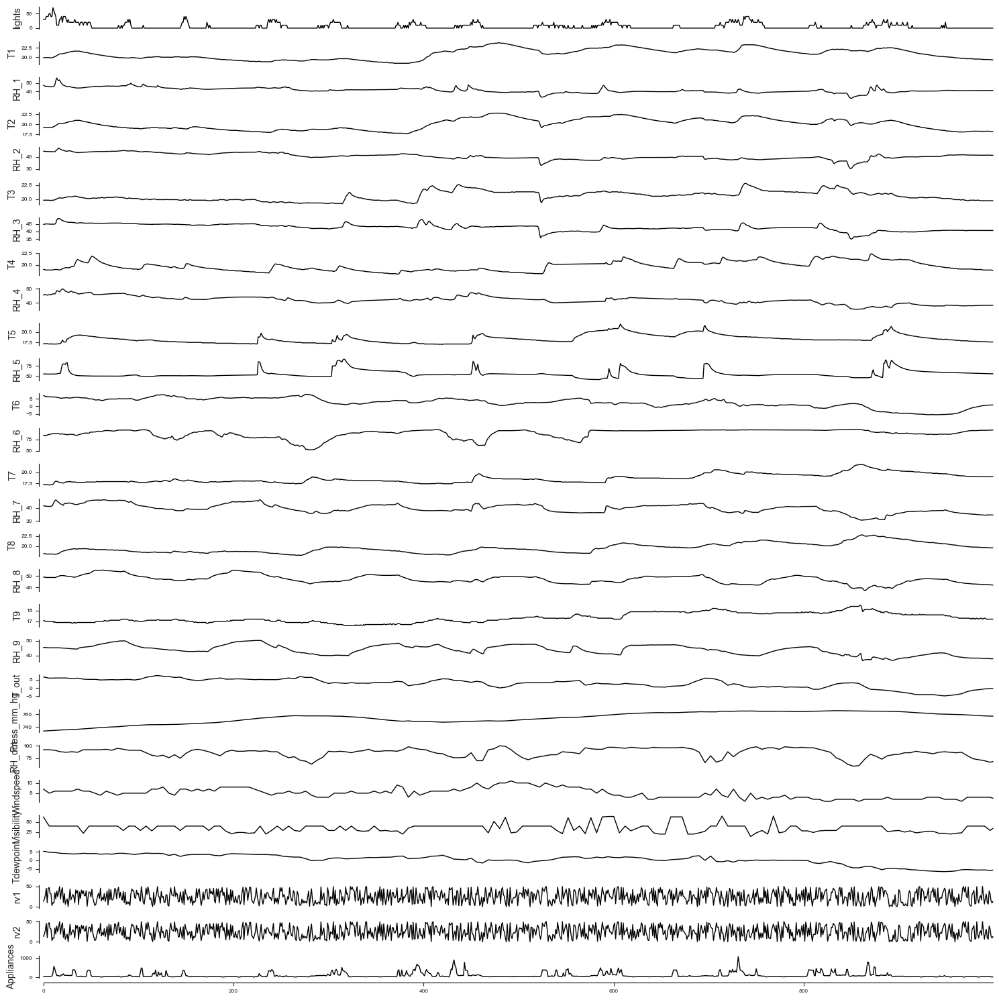

In [63]:
tp.plot_timeseries(df_full_pp, figsize=(15, 15))
plt.show()

In [64]:
parcorr = ParCorr(significance='analytic')
pcmci = PCMCI(
    dataframe=df_full_pp, 
    cond_ind_test=parcorr,
    verbosity=1)
correlations = pcmci.get_lagged_dependencies(tau_max=20, val_only=True)['val_matrix']


##
## Estimating lagged dependencies 
##

Parameters:

independence test = par_corr
tau_min = 0
tau_max = 20


In [65]:
correlations.shape

(28, 28, 21)

In [67]:
matrix_lags = None #np.argmax(np.abs(correlations), axis=2)
# tp.plot_scatterplots(dataframe=df_full_pp, add_scatterplot_args={'matrix_lags':matrix_lags}); plt.show()

In [68]:
# tp.plot_densityplots(dataframe=df_full_pp, add_densityplot_args={'matrix_lags':matrix_lags})
# plt.show()

In [69]:
parcorr = ParCorr(significance='analytic')
pcmci = PCMCI(
    dataframe=df_full_pp, 
    cond_ind_test=parcorr,
    verbosity=1)

In [72]:
#correlations = pcmci.get_lagged_dependencies(tau_max=20, val_only=True)['val_matrix']
#lag_func_matrix = tp.plot_lagfuncs(val_matrix=correlations, setup_args={'var_names': df_filtered.columns, 
#                                    'x_base':5, 'y_base':.5}); #plt.show()

In [75]:
pcmci.verbosity = 1
results = pcmci.run_pcmci(tau_max=5, pc_alpha=None, alpha_level=0.01)


##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = par_corr
tau_min = 1
tau_max = 5
pc_alpha = [0.05, 0.1, 0.2, 0.3, 0.4, 0.5]
max_conds_dim = None
max_combinations = 1



## Variable lights

Iterating through pc_alpha = [0.05, 0.1, 0.2, 0.3, 0.4, 0.5]:

# pc_alpha = 0.05 (1/6):

Testing condition sets of dimension 0:

    Link (lights -1) -?> lights (1/140):
    Subset 0: () gives pval = 0.00000 / val =  0.838
    No conditions of dimension 0 left.

    Link (lights -2) -?> lights (2/140):
    Subset 0: () gives pval = 0.00000 / val =  0.797
    No conditions of dimension 0 left.

    Link (lights -3) -?> lights (3/140):
    Subset 0: () gives pval = 0.00000 / val =  0.718
    No conditions of dimension 0 left.

    Link (lights -4) -?> lights (4/140):
    Subset 0: () gives pval = 0.00000 / val =  0.670
    No conditions of dimension 0 left.

    Link (lights -5) -?> lights (5/140):
    Subset 0: () gives pval = 0.00000 / val =  0.611
   

In [78]:
q_matrix = pcmci.get_corrected_pvalues(p_matrix=results['p_matrix'], tau_max=5, fdr_method='fdr_bh')
pcmci.print_significant_links(
        p_matrix = q_matrix,
        val_matrix = results['val_matrix'],
        alpha_level = 0.01)
graph = pcmci.get_graph_from_pmatrix(p_matrix=q_matrix, alpha_level=0.01, 
            tau_min=0, tau_max=5, link_assumptions=None)
results['graph'] = graph


## Significant links at alpha = 0.01:

    Variable lights has 6 link(s):
        (lights -1): pval = 0.00000 | val =  0.466
        (lights -2): pval = 0.00000 | val =  0.271
        (RH_7  0): pval = 0.00000 | val =  0.166
        (T4  0): pval = 0.00002 | val =  0.137
        (Appliances  0): pval = 0.00192 | val =  0.099
        (RH_4  0): pval = 0.00540 | val =  0.090

    Variable T1 has 8 link(s):
        (T1 -1): pval = 0.00000 | val =  0.697
        (T2 -1): pval = 0.00000 | val =  0.351
        (T2  0): pval = 0.00000 | val =  0.333
        (RH_1  0): pval = 0.00000 | val =  0.171
        (T2 -2): pval = 0.00001 | val = -0.164
        (RH_2  0): pval = 0.00000 | val =  0.148
        (RH_1 -1): pval = 0.00024 | val =  0.146
        (T3  0): pval = 0.00001 | val =  0.140

    Variable RH_1 has 11 link(s):
        (RH_1 -1): pval = 0.00000 | val =  0.766
        (RH_2  0): pval = 0.00000 | val =  0.380
        (RH_1 -2): pval = 0.00000 | val = -0.347
        (RH_3  0): pval = 0

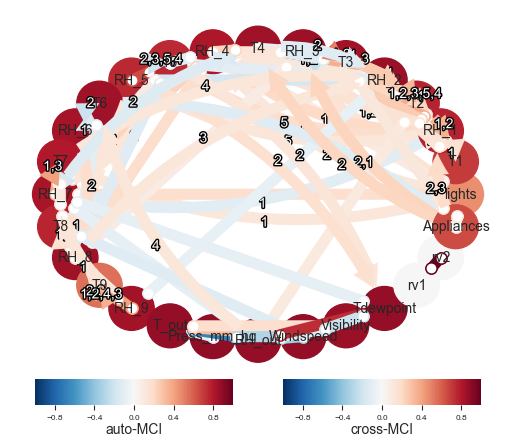

In [79]:
tp.plot_graph(
    val_matrix=results['val_matrix'],
    graph=results['graph'],
    var_names=df_filtered.columns,
    link_colorbar_label='cross-MCI',
    node_colorbar_label='auto-MCI',
    show_autodependency_lags=False
    ); plt.show()

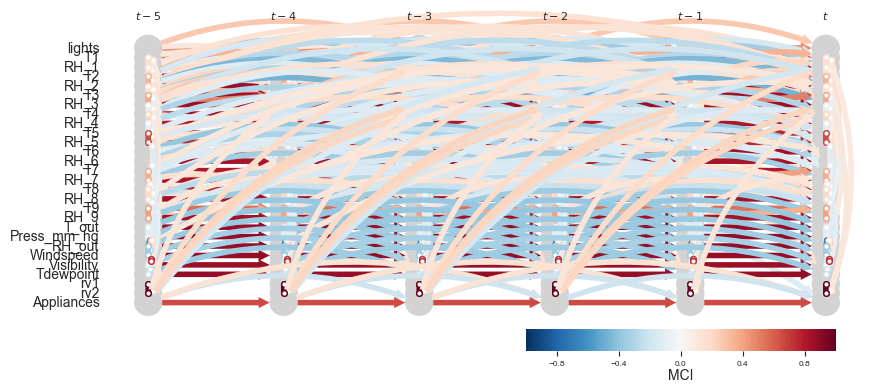

In [80]:
# Plot time series graph    
tp.plot_time_series_graph(
    figsize=(10, 4),
    val_matrix=results['val_matrix'],
    graph=results['graph'],
    var_names=df_filtered.columns,
    link_colorbar_label='MCI',
    ); plt.show()